# 2023 OHBM | A multimodal ultrahigh-field MRI processing pipeline

In [35]:
import pandas as pd
import numpy as np
import os
import glob
import nibabel as nb
import scipy.stats
from brainspace.mesh.mesh_io import read_surface
from brainspace.plotting import plot_hemispheres
from brainspace.gradient import GradientMaps
from brainspace.mesh.array_operations import smooth_array
from brainstat.stats.SLM import SLM
from brainstat.stats.terms import FixedEffect
from brainstat.datasets.base import combine_surfaces
import seaborn as sns

# Path to MICAPIPE
micapipe=os.popen("echo $MICAPIPE").read()[:-1]

# Load native mid surface
inf_lh = read_surface(micapipe + '/surfaces/fsLR-5k.L.inflated.surf.gii', itype='gii')
inf_rh = read_surface(micapipe + '/surfaces/fsLR-5k.R.inflated.surf.gii', itype='gii')
mask_lh =  nb.load(micapipe + '/surfaces/fsLR-5k.R.mask.shape.gii').darrays[0].data
mask_rh =  nb.load(micapipe + '/surfaces/fsLR-5k.L.mask.shape.gii').darrays[0].data
mask_10k = np.concatenate((mask_lh, mask_rh), axis=0)

# Labels and boolean mask
mask_surf = mask_10k != 0

# load stuff
from brainspace.datasets import load_mask
mask_32k = load_mask(join=True)

inf32_lh = read_surface(micapipe + '/surfaces/fsLR-32k.L.inflated.surf.gii', itype='gii')
inf32_rh = read_surface(micapipe + '/surfaces/fsLR-32k.R.inflated.surf.gii', itype='gii')

In [28]:
# Set dataset PNI as working directory
os.chdir('/data_/mica3')

# List of subjects
subs_mic = ['HC076', 'HC062', 'HC083', 'HC081', 'HC082']
subs_pni = ['PNC018', 'PNC019', 'PNC011', 'PNC006', 'PNC003']

# full path to 
dir_mic = 'BIDS_MICs'
dir_pni = 'BIDS_PNI'

# For MIC subjects
dirs_mic = []
for sub in subs_mic:
    dirs_mic.extend(glob.glob(f'{dir_mic}/derivatives/micapipe_v0.2.0/sub-{sub}/ses-*'))

# For PNI subjects
dirs_pni = []
for sub in subs_pni:
    dirs_pni.extend(glob.glob(f'{dir_pni}/derivatives/micapipe_v0.2.0/sub-{sub}/ses-*'))


In [115]:
def load_qmri_group(qmri='', subjects_list=None, maps='maps'):
    '''
    This function loads and plots the qMRI intensity maps on fsLR32k midthickness
    '''
    # List the files
    files_lh = []
    for path in subjects_list:
        files_lh.extend(glob.glob(f'{path}/{maps}/*_hemi-L_surf-fsLR-32k{qmri}.func.gii'))
    files_rh = []
    for path in subjects_list:
        files_rh.extend(glob.glob(f'{path}/{maps}/*_hemi-R_surf-fsLR-32k{qmri}.func.gii'))    
    
    files_lh = sorted(files_lh)
    files_rh = sorted(files_rh)

    # Load all the thickness data
    Nqmri=np.concatenate((nb.load(files_lh[0]).darrays[0].data, nb.load(files_rh[0]).darrays[0].data), axis=0).shape[0]

    surf_map=np.empty([len(files_lh), Nqmri], dtype=float)
    for i, _ in enumerate(files_lh):
        surf_map[i,:] = np.hstack(np.concatenate((nb.load(files_lh[i]).darrays[0].data, nb.load(files_rh[i]).darrays[0].data), axis=0))

    # Mean matrix across the x axis (vertices)
    map_mean = np.mean(surf_map, axis=0)
    
    N = surf_map.shape[0]
    print(f"Numer of {qmri} maps: {N}")               
    return(map_mean,surf_map)

def plot_qmri_int(qmri='', midwall_mask=False, cmap='rocket', horiz=False, rq=(0.01, 0.99), 
                  subjects_list=None, crange=False, maps='maps'):
    
    # Load the data
    map_mean,_ = load_qmri_group(qmri, subjects_list=subjects_list, maps=maps)
    
    if crange == False:
        # Plot the group T1map intensitites
        crange=(np.quantile(map_mean[mask_32k], rq[0]), np.quantile(map_mean[mask_32k], rq[1]))

    # Replace values in f with NaN where mask_32k is False
    if midwall_mask == True: map_mean[mask_32k == False] = np.nan
    
    if horiz == True:
        fig = plot_hemispheres(inf32_lh, inf32_rh, array_name=map_mean, size=(900, 250), color_bar='bottom', zoom=1.25, embed_nb=True, interactive=False, share='both',
                     nan_color=(0, 0, 0, 1), cmap=cmap, color_range=crange, transparent_bg=True, screenshot = False)

    else:
        fig = plot_hemispheres(inf32_lh, inf32_rh, array_name=map_mean, cmap=cmap, nan_color=(0, 0, 0, 1), transparent_bg=True,
                  zoom=1.3, size=(900, 750), embed_nb=True, color_bar='right', layout_style='grid', color_range=crange,
                  label_text={'left': ['Lateral', 'Medial'], 'top': ['Left', 'Right']}, screenshot=False)
    return(fig)

import cmocean
cmaps = cmocean.cm.cmap_d

Numer of _label-thickness maps: 18


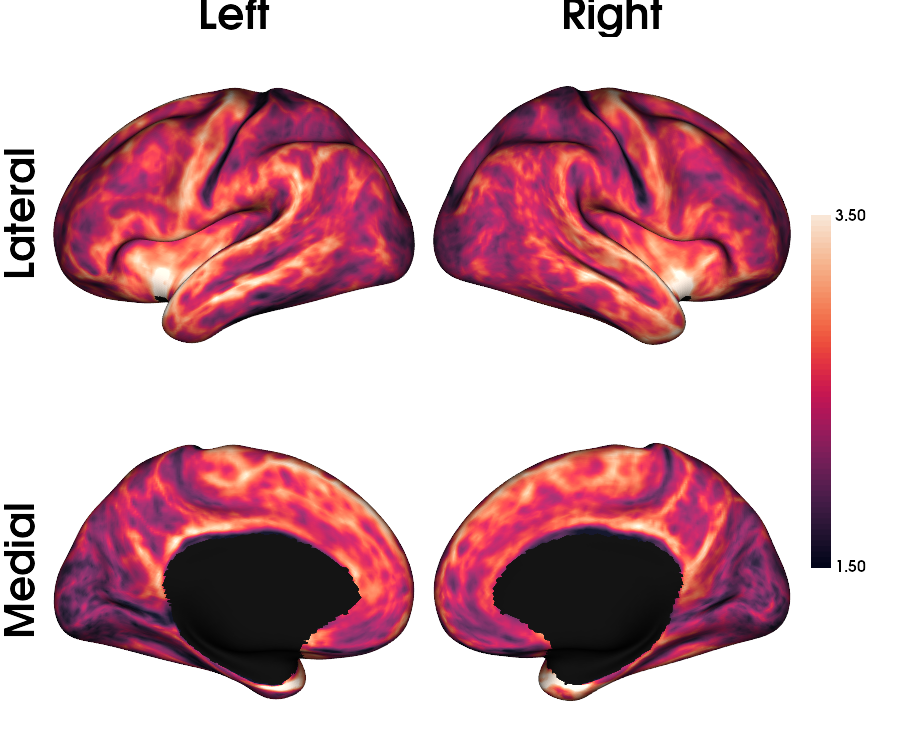

In [101]:
plot_qmri_int(qmri='_label-thickness', midwall_mask=True, cmap='rocket', 
              horiz=False, subjects_list=dirs_pni, crange=(1.5,3.5))

Numer of _label-thickness maps: 10


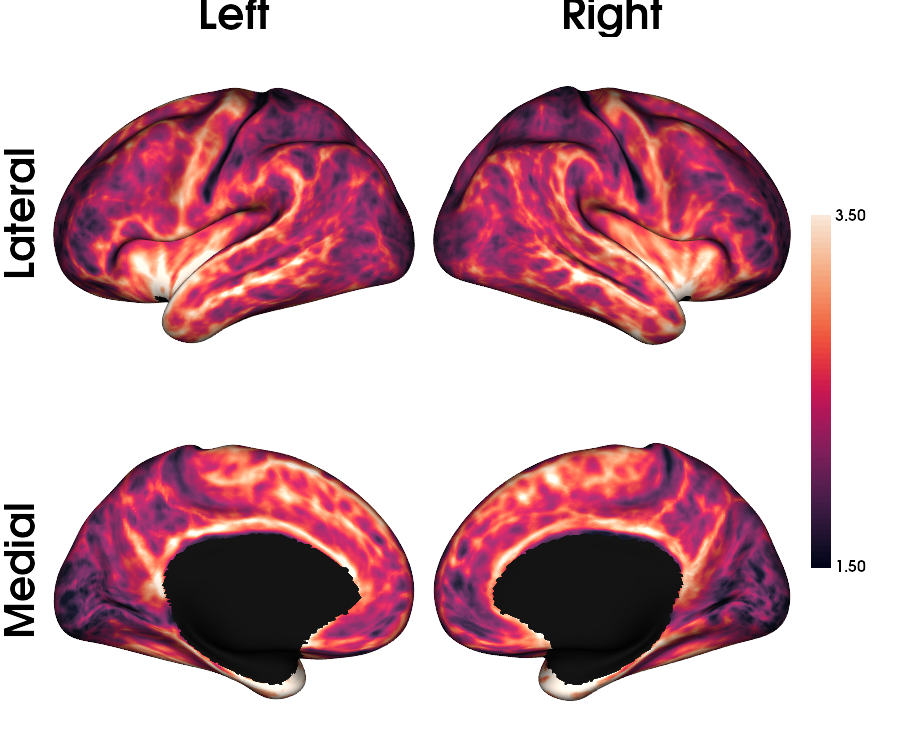

In [102]:
plot_qmri_int(qmri='_label-thickness', midwall_mask=True, cmap='rocket', 
              horiz=False, subjects_list=dirs_mic, crange=(1.5,3.5))

Numer of _label-midthickness_ADC maps: 8


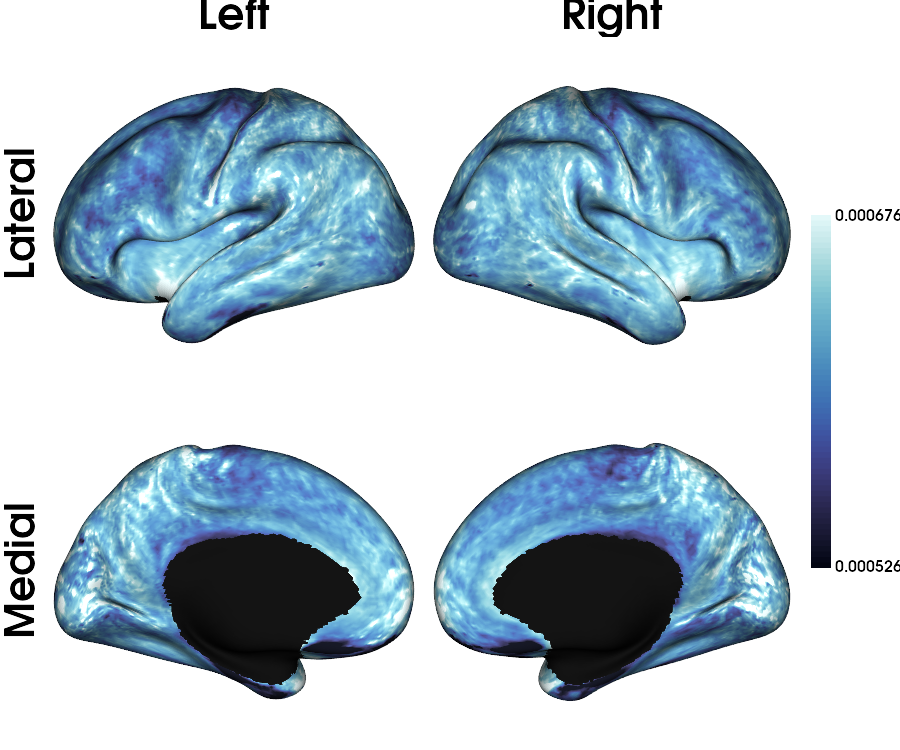

In [121]:
plot_qmri_int(qmri='_label-midthickness_ADC', midwall_mask=True, cmap='cmo.ice', 
              horiz=False, subjects_list=dirs_mic, rq=(0.01, 0.975))

Numer of _label-midthickness_ADC maps: 10


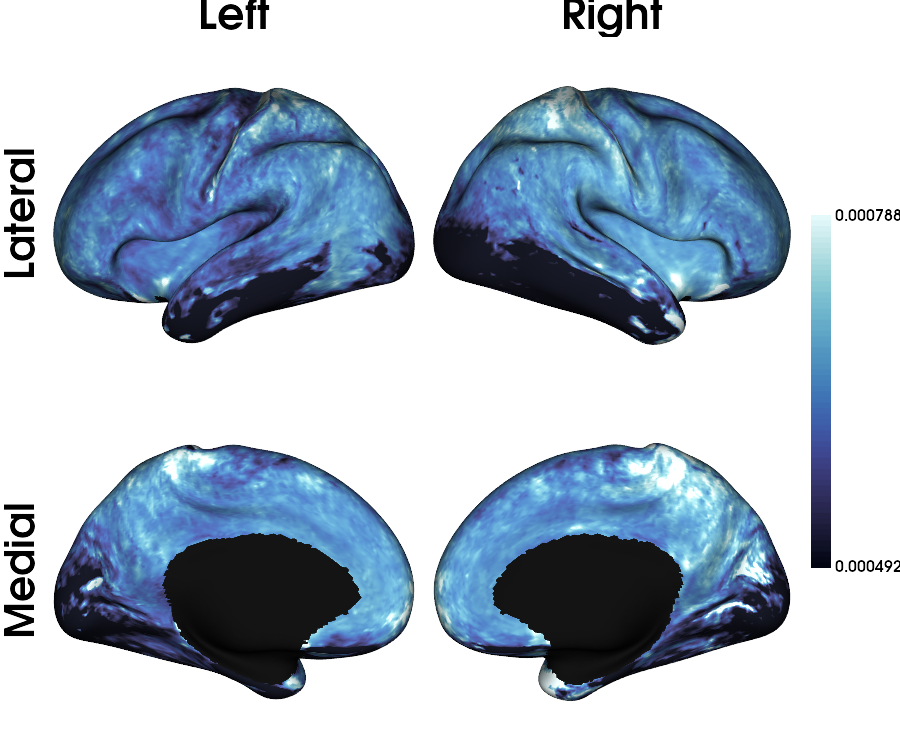

In [122]:
plot_qmri_int(qmri='_label-midthickness_ADC', midwall_mask=True, cmap='cmo.ice', 
              horiz=False, subjects_list=dirs_pni, rq=(0.1, 0.975))

Numer of _label-midthickness_T1map maps: 15


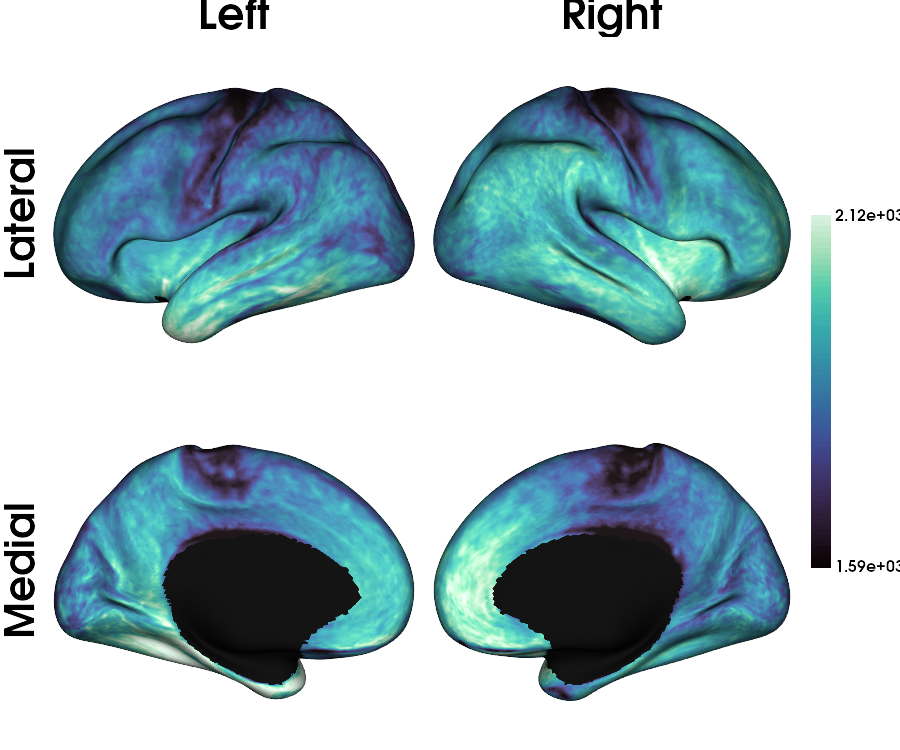

In [116]:
plot_qmri_int(qmri='_label-midthickness_T1map', midwall_mask=True, cmap='mako', 
              horiz=False, subjects_list=dirs_pni, rq=(0.01, 0.99))

Numer of _label-midthickness_T1map maps: 9


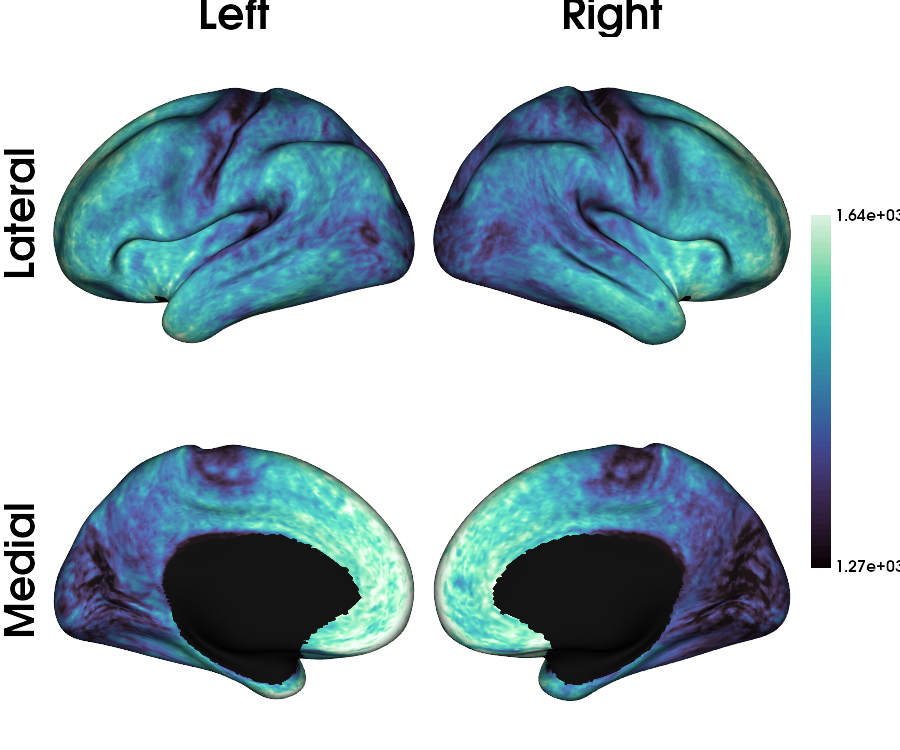

In [117]:
plot_qmri_int(qmri='_label-midthickness_T1map', midwall_mask=True, cmap='mako', 
              horiz=False, subjects_list=dirs_mic, rq=(0.01, 0.99))

Numer of  maps: 17


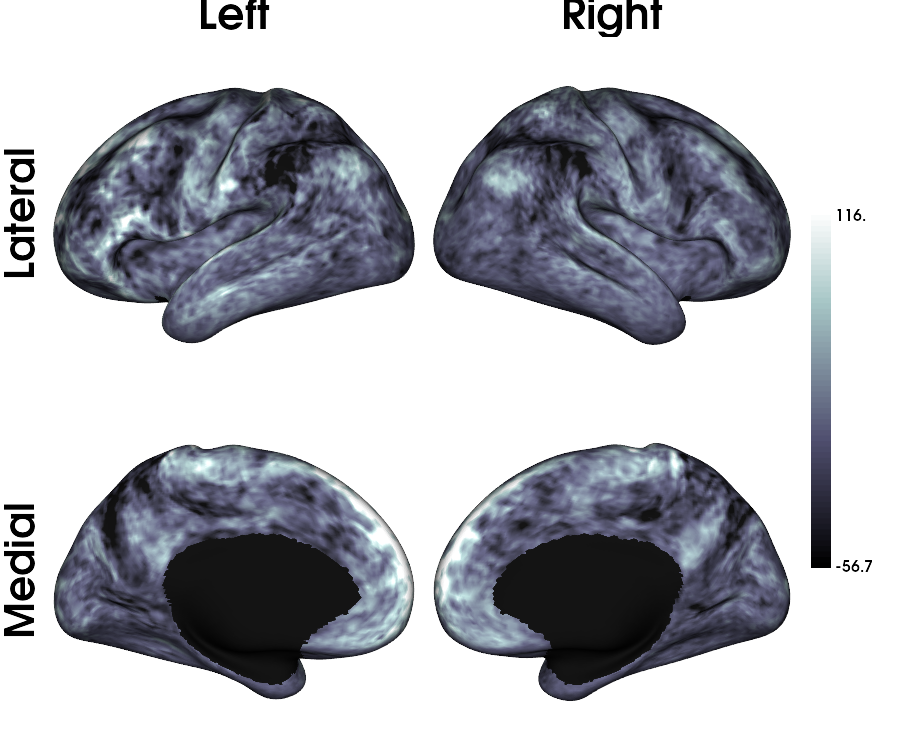

In [118]:
plot_qmri_int(qmri='', midwall_mask=True, cmap='bone', 
              horiz=False, subjects_list=dirs_pni, rq=(0.01, 0.99), maps='func/desc-me_task-rest_bold/surf')

Numer of  maps: 8


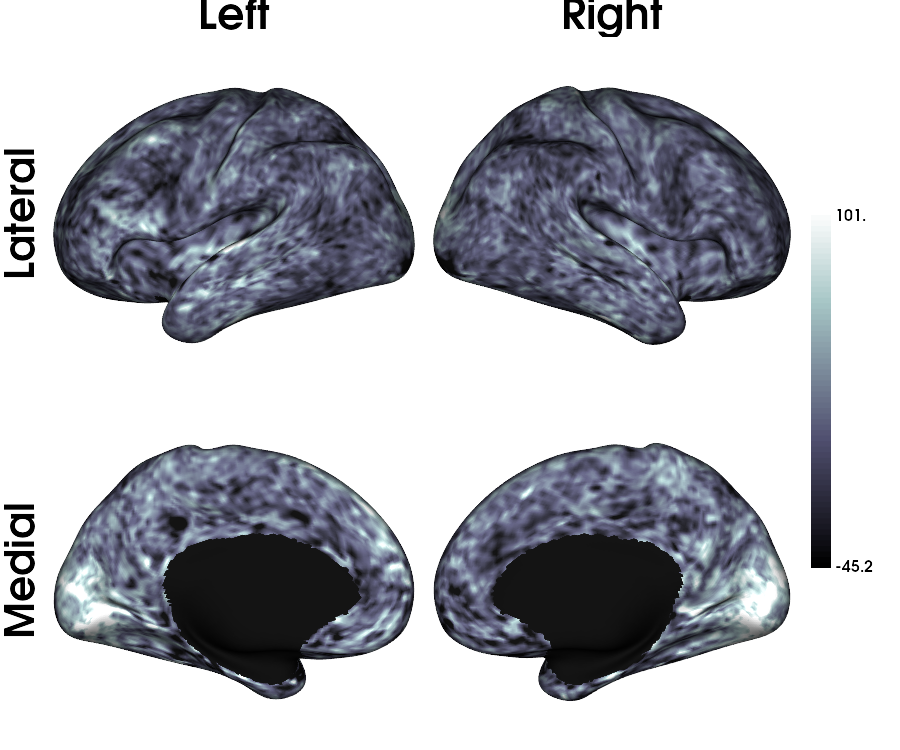

In [120]:
plot_qmri_int(qmri='', midwall_mask=True, cmap='bone', 
              horiz=False, subjects_list=dirs_mic, rq=(0.01, 0.99), maps='func/desc-se_task-rest_acq-AP_bold/surf')

In [123]:
# Functions to load the 5k connectomes

In [124]:
def load_mpc(File):
    """Loads and process a MPC"""

    # Load file
    mpc = nb.load(File).darrays[0].data
    
    # Mirror the lower triangle
    mpc = np.triu(mpc,1)+mpc.T
    
    # Replace infinite values with epsilon
    mpc[~np.isfinite(mpc)] = np.finfo(float).eps
    
    # Replace 0 with epsilon
    mpc[mpc==0] = np.finfo(float).eps
    
    # retun the MPC
    return(mpc)

def load_gd(File):
    """Loads and process a GD"""
    
    # load the matrix
    mtx_gd = nb.load(File).darrays[0].data
    
    return mtx_gd

def load_fc(File):
    """Loads and process a functional connectome"""
    
    # load the matrix
    FC = nb.load(File).darrays[0].data
    
    # Fisher transform
    FCz = np.arctanh(FC)

    # replace inf with 0
    FCz[~np.isfinite(FCz)] = 0
    
    # Mirror the matrix
    FCz = np.triu(FCz,1)+FCz.T
    return FCz

def load_sc(File):
    """Loads and process a structura connectome"""
    
    # load the matrix
    mtx_sc = nb.load(File).darrays[0].data
    
    # Mirror the matrix
    mtx_sc = np.triu(mtx_sc,1)+mtx_sc.T
    
    return mtx_sc

In [130]:
import seaborn as sns
import matplotlib.pyplot as plt
def plot_connectome(mtx, Title='matrix plot', xlab='X', ylab='Y', col='rocket', vmin=None, vmax=None,
                   xticklabels='auto', yticklabels='auto',xrot=90, yrot=0):
    
    '''
    This optional function, only plots a connectome as a heatmap
    Parameters
    ----------
    mtx : np.array
    Returns
    -------
    f : plot
    '''
    f, ax = plt.subplots(figsize=(15,10))
    g = sns.heatmap(mtx, ax=ax, cmap=col, vmin=vmin, vmax=vmax, xticklabels=xticklabels, yticklabels=yticklabels)
    g.set_xlabel(xlab)
    g.set_ylabel(ylab)
    g.set_title(Title)
    # Rotate the x-axis labels
    # rotate tick labels
    ax.set_xticklabels(ax.get_xticklabels(), rotation=xrot, ha='right')
    ax.set_yticklabels(ax.get_yticklabels(), rotation=yrot, ha='right')

In [126]:
# Shape of the fsLR-5k matrices
N5k = 9684

# 7T Geodesic Distance

In [192]:
# List the files
gd_file = []
for path in dirs_pni:
    gd_file.extend(glob.glob(f'{path}/dist/*_surf-fsLR-5k_GD.shape.gii'))
        
N = len(gd_file)
print(f"Numer of GD: {N}")   
    
# Loads all the GD fsLR-5k matrices
gd_5k=np.empty([N5k, N5k, len(gd_file)], dtype=float)
for i, f in enumerate(gd_file):
    gd_5k[:,:,i] = load_gd(f)

# Calculate the mean connectome
gd_5k_mean = np.mean(gd_5k, axis=2)

Numer of GD: 15


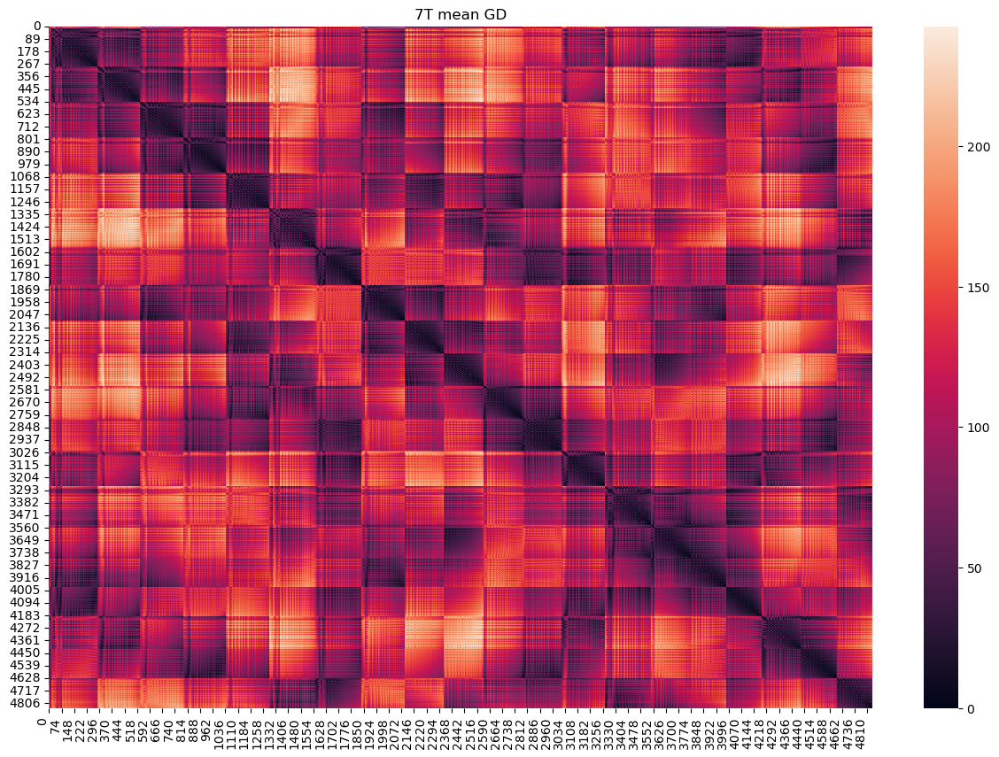

In [193]:
# plot the matrix connectome
plot_connectome(gd_5k_mean[0:4842,0:4842], Title='7T mean GD', xlab='', ylab='', col='rocket', vmin=None, vmax=None,
                   xticklabels='auto', yticklabels='auto',xrot=90, yrot=0)

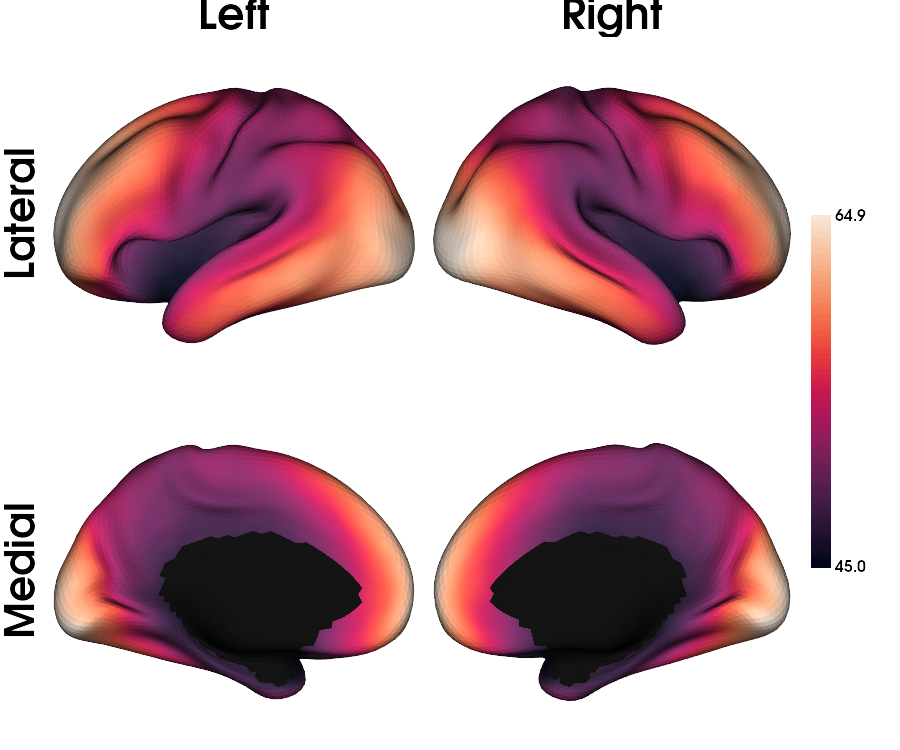

In [194]:
# Calculate the column mean
map_mean=np.mean(gd_5k_mean, axis=1)
# plot the column mean of the mean connectome surface
crange=(np.quantile(map_mean[mask_surf], 0.01), np.quantile(map_mean[mask_surf], 0.99))
map_mean[mask_surf == False] = np.nan

plot_hemispheres(inf_lh, inf_rh, array_name=map_mean, cmap='rocket', nan_color=(0, 0, 0, 1), 
                 transparent_bg=True, zoom=1.3, size=(900, 750), embed_nb=True, color_bar='right', 
                 layout_style='grid', color_range=crange,
                 label_text={'left': ['Lateral', 'Medial'], 'top': ['Left', 'Right']}, screenshot=False)

Numer of GD: 10


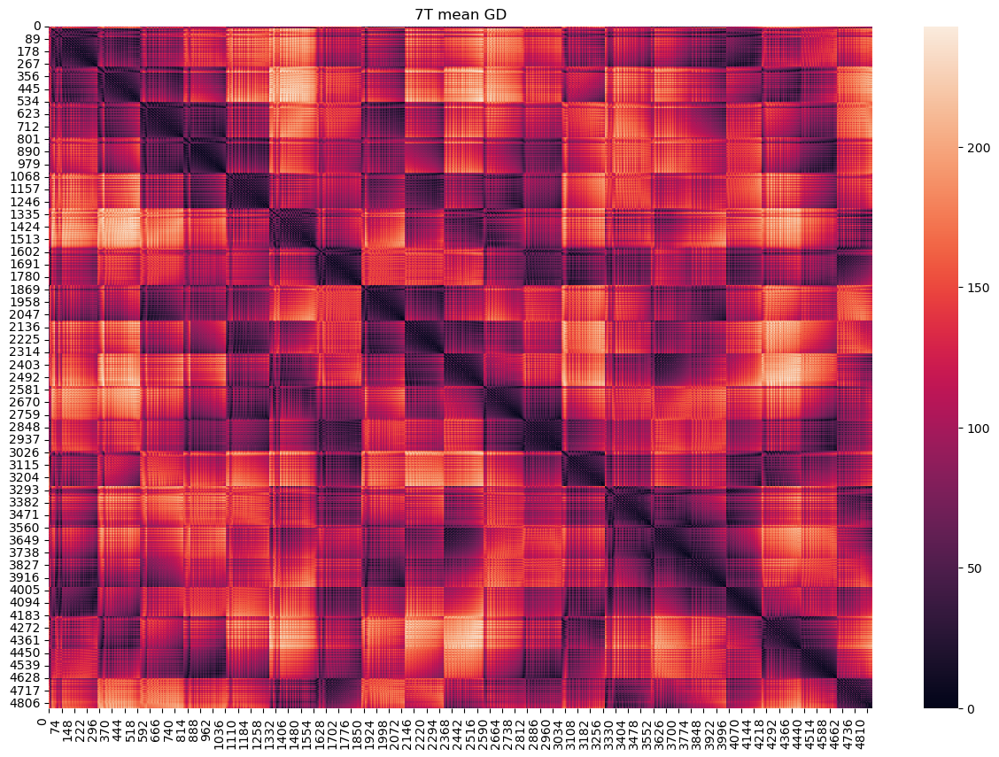

In [195]:
# List the files
gd_file = []
for path in dirs_mic:
    gd_file.extend(glob.glob(f'{path}/dist/*_surf-fsLR-5k_GD.shape.gii'))
        
N = len(gd_file)
print(f"Numer of GD: {N}")   
    
# Loads all the GD fsLR-5k matrices
gd_5k=np.empty([N5k, N5k, len(gd_file)], dtype=float)
for i, f in enumerate(gd_file):
    gd_5k[:,:,i] = load_gd(f)

# Calculate the mean connectome
gd_5k_mean = np.mean(gd_5k, axis=2)

# plot the matrix connectome
plot_connectome(gd_5k_mean[0:4842,0:4842], Title='7T mean GD', xlab='', ylab='', col='rocket', vmin=None, vmax=None,
                   xticklabels='auto', yticklabels='auto',xrot=90, yrot=0)

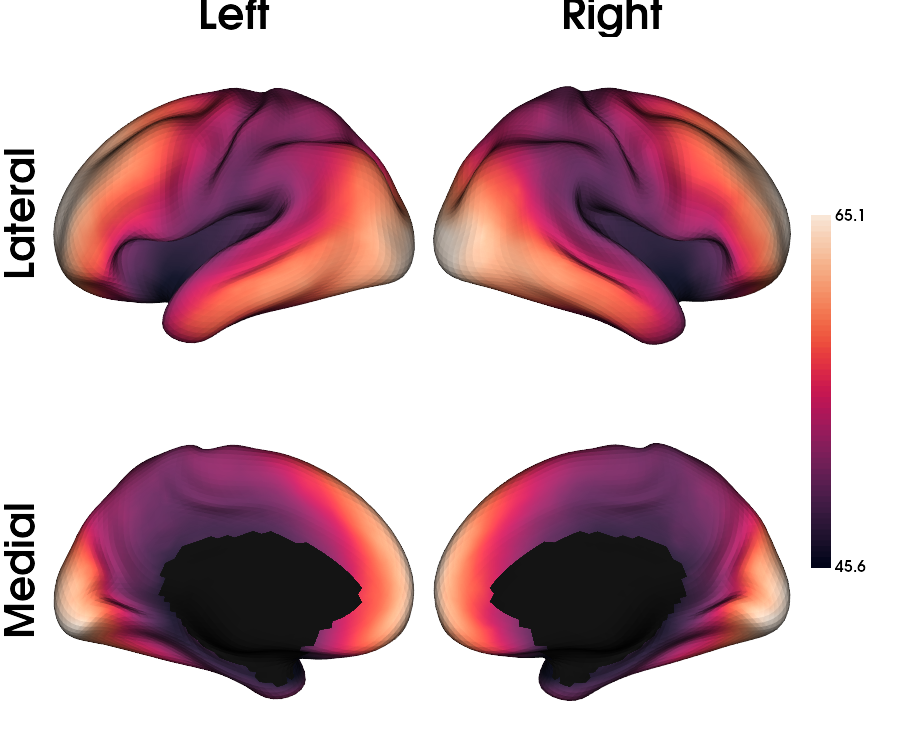

In [196]:
# Calculate the column mean
map_mean=np.mean(gd_5k_mean, axis=1)

# plot the column mean of the mean connectome surface
crange=(np.quantile(map_mean[mask_surf], 0.01), np.quantile(map_mean[mask_surf], 0.99))
map_mean[mask_surf == False] = np.nan

plot_hemispheres(inf_lh, inf_rh, array_name=map_mean, cmap='rocket', nan_color=(0, 0, 0, 1), 
                 transparent_bg=True, zoom=1.3, size=(900, 750), embed_nb=True, color_bar='right', 
                 layout_style='grid', color_range=crange,
                 label_text={'left': ['Lateral', 'Medial'], 'top': ['Left', 'Right']}, screenshot=False)

# 3T Structural Connectome

In [197]:
# List the files
sc_file = []
for path in dirs_mic:
    sc_file.extend(glob.glob(f'{path}/dwi/connectomes/*_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii'))
        
print(f"Numer of SC: {N}") 

# Loads all the SC fsLR-5k matrices
sc_5k=np.empty([N5k, N5k, len(sc_file)], dtype=float)

# Load the SC and weight it by the edge length
for i, f in enumerate(sc_file):
    sc_5k[:,:,i] = load_sc(f)
    
# Calculate the mean connectome
sc_5k_mean = np.mean(sc_5k, axis=2)

sc_file

Numer of SC: 10


['BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC076/ses-01/dwi/connectomes/sub-HC076_ses-01_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC076/ses-02/dwi/connectomes/sub-HC076_ses-02_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC083/ses-01/dwi/connectomes/sub-HC083_ses-01_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC081/ses-01/dwi/connectomes/sub-HC081_ses-01_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC081/ses-02/dwi/connectomes/sub-HC081_ses-02_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC082/ses-01/dwi/connectomes/sub-HC082_ses-01_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC082/ses-02/dwi/connectomes/sub-HC082_ses-0

/host/yeatman/local_raid/temporaryLocalProcessing/ipykernel_37091/1785428367.py:2: RuntimeWarning: divide by zero encountered in log
  sc_5k_mean_log = np.log(sc_5k_mean)


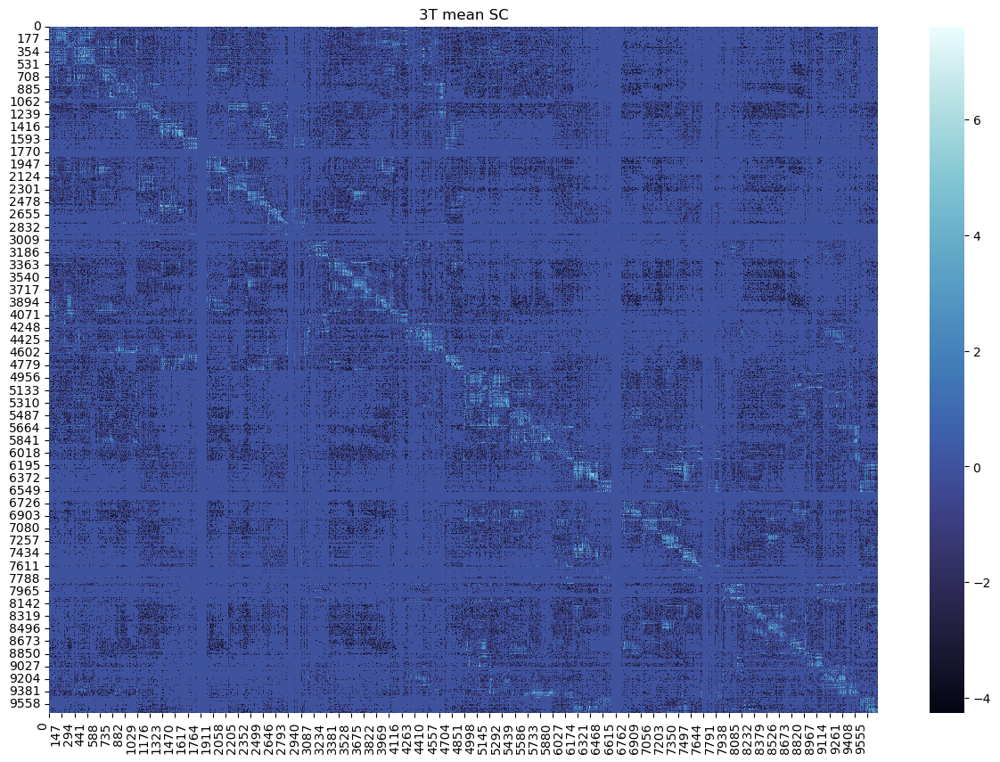

In [198]:
# Log transfor the matrix for visualization
sc_5k_mean_log = np.log(sc_5k_mean)
sc_5k_mean_log[np.isneginf(sc_5k_mean_log)] = 0

# plot the matrix connectome
plot_connectome(sc_5k_mean_log, Title='3T mean SC', xlab='', ylab='', col='cmo.ice', vmin=None, vmax=None,
                   xticklabels='auto', yticklabels='auto',xrot=90, yrot=0)

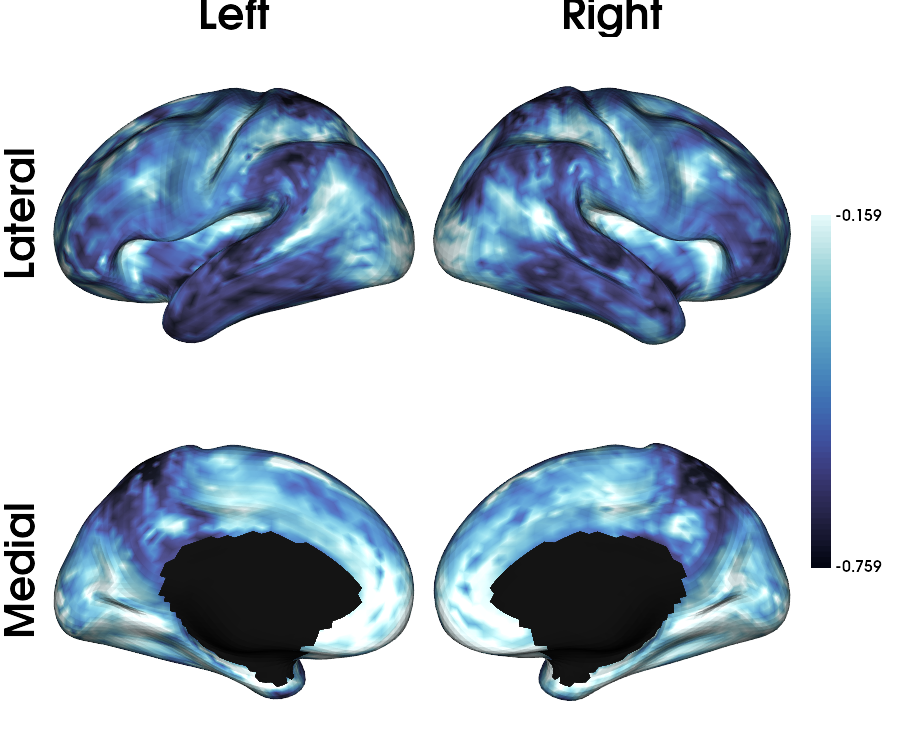

In [199]:
# Calculate the column mean
map_mean=np.mean(sc_5k_mean_log, axis=1)
    
# plot the column mean of the mean connectome surface
crange=(np.quantile(map_mean[mask_surf], 0.01), np.quantile(map_mean[mask_surf], 0.95))
map_mean[mask_surf == False] = np.nan

plot_hemispheres(inf_lh, inf_rh, array_name=map_mean, cmap='cmo.ice', nan_color=(0, 0, 0, 1), 
                 transparent_bg=True, zoom=1.3, size=(900, 750), embed_nb=True, color_bar='right', 
                 layout_style='grid', color_range=crange,
                 label_text={'left': ['Lateral', 'Medial'], 'top': ['Left', 'Right']}, screenshot=False)

# 7T Structural Connectome

In [200]:
# List the files
sc_file = []
for path in dirs_pni:
    sc_file.extend(glob.glob(f'{path}/dwi/connectomes/*_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii'))
        
print(f"Numer of SC: {N}") 

# Loads all the SC fsLR-5k matrices
sc_5k=np.empty([N5k, N5k, len(sc_file)], dtype=float)

# Load the SC and weight it by the edge length
for i, f in enumerate(sc_file):
    sc_5k[:,:,i] = load_sc(f)
    
# Calculate the mean connectome
sc_5k_mean = np.mean(sc_5k, axis=2)

sc_file

Numer of SC: 10


['BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC018/ses-01/dwi/connectomes/sub-PNC018_ses-01_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC018/ses-02/dwi/connectomes/sub-PNC018_ses-02_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC019/ses-01/dwi/connectomes/sub-PNC019_ses-01_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC019/ses-02/dwi/connectomes/sub-PNC019_ses-02_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC011/ses-01/dwi/connectomes/sub-PNC011_ses-01_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC011/ses-02/dwi/connectomes/sub-PNC011_ses-02_surf-fsLR-5k_desc-iFOD2-40M-SIFT2_full-connectome.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC006/ses-01/dwi/connectomes/sub-PNC00

/host/yeatman/local_raid/temporaryLocalProcessing/ipykernel_37091/1372621251.py:2: RuntimeWarning: divide by zero encountered in log
  sc_5k_mean_log = np.log(sc_5k_mean)


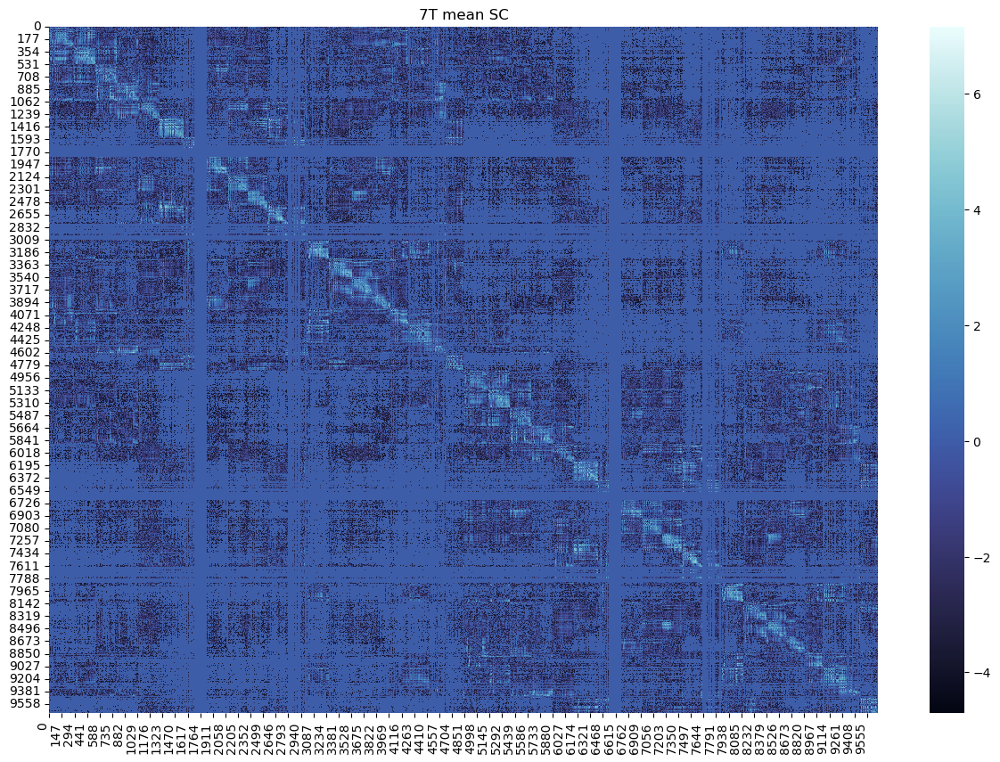

In [201]:
# Log transfor the matrix for visualization
sc_5k_mean_log = np.log(sc_5k_mean)
sc_5k_mean_log[np.isneginf(sc_5k_mean_log)] = 0

# plot the matrix connectome
plot_connectome(sc_5k_mean_log, Title='7T mean SC', xlab='', ylab='', col='cmo.ice', vmin=None, vmax=None,
                   xticklabels='auto', yticklabels='auto',xrot=90, yrot=0)

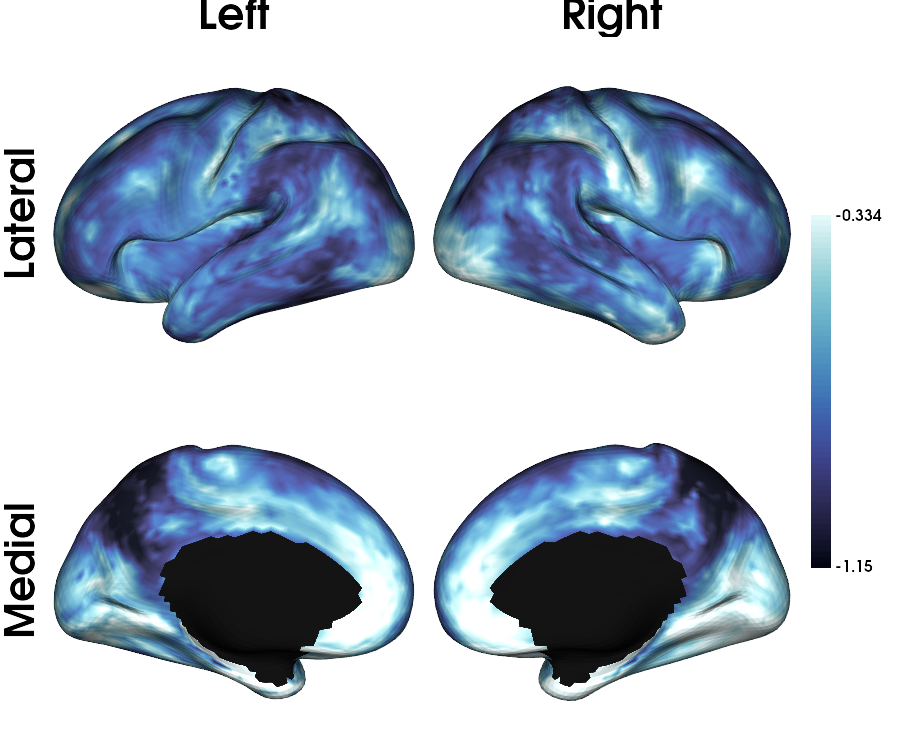

In [202]:
# Calculate the column mean
map_mean=np.mean(sc_5k_mean_log, axis=1)
    
# plot the column mean of the mean connectome surface
crange=(np.quantile(map_mean[mask_surf], 0.01), np.quantile(map_mean[mask_surf], 0.95))
map_mean[mask_surf == False] = np.nan

plot_hemispheres(inf_lh, inf_rh, array_name=map_mean, cmap='cmo.ice', nan_color=(0, 0, 0, 1), 
                 transparent_bg=True, zoom=1.3, size=(900, 750), embed_nb=True, color_bar='right', 
                 layout_style='grid', color_range=crange,
                 label_text={'left': ['Lateral', 'Medial'], 'top': ['Left', 'Right']}, screenshot=False)

# 7T MPC connectome

In [203]:
# MPC T1map
qmri='T1map'
mpc_file = []
for path in dirs_pni:
    mpc_file.extend(glob.glob(f'{path}/mpc/acq-{qmri}/*surf-fsLR-5k_desc-MPC.shape.gii'))
N = len(mpc_file) 
print(f"Numer of MPC: {N}") 

# Loads all the MPC fsLR-5k matrices
mpc_5k=np.empty([N5k, N5k, len(mpc_file)], dtype=float)
for i, f in enumerate(mpc_file):
    mpc_5k[:,:,i] = load_mpc(f)
    
# Mean group MPC colums
mpc_5k_mean = np.mean(mpc_5k, axis=2)

mpc_file

Numer of MPC: 15


['BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC018/ses-03/mpc/acq-T1map/sub-PNC018_ses-03_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC018/ses-01/mpc/acq-T1map/sub-PNC018_ses-01_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC018/ses-02/mpc/acq-T1map/sub-PNC018_ses-02_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC018/ses-04/mpc/acq-T1map/sub-PNC018_ses-04_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC019/ses-03/mpc/acq-T1map/sub-PNC019_ses-03_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC019/ses-01/mpc/acq-T1map/sub-PNC019_ses-01_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC019/ses-02/mpc/acq-T1map/sub-PNC019_ses-02_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC011/ses-01/mpc/acq-T1map/sub-PNC011_ses-01_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_PNI/deriv

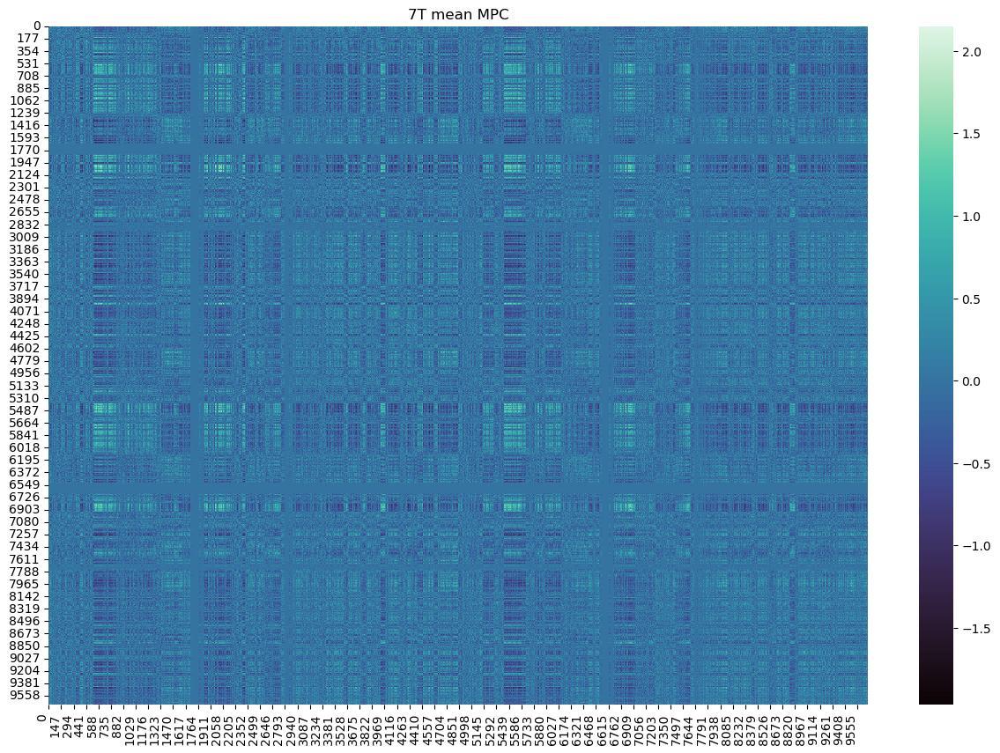

In [204]:
# plot the matrix connectome
plot_connectome(mpc_5k_mean, Title='7T mean MPC', xlab='', ylab='', col='mako', vmin=None, vmax=None,
                   xticklabels='auto', yticklabels='auto',xrot=90, yrot=0)

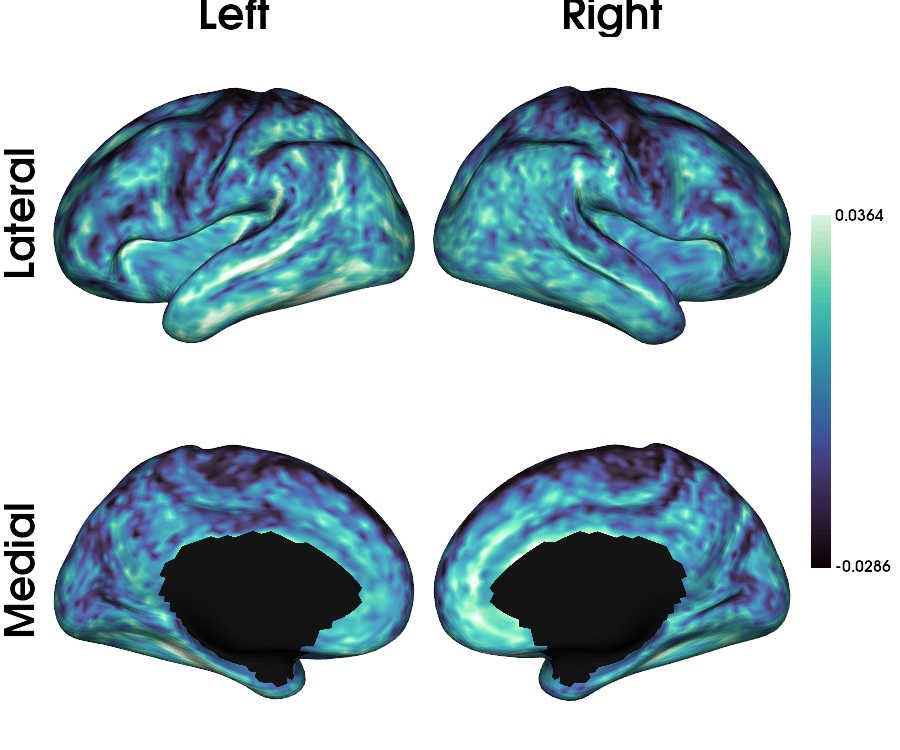

In [205]:
# Calculate the column mean
map_mean=np.mean(mpc_5k_mean, axis=1)

# plot the column mean of the mean connectome surface
crange=(np.quantile(map_mean[mask_surf], 0.01), np.quantile(map_mean[mask_surf], 0.99))
map_mean[mask_surf == False] = np.nan

plot_hemispheres(inf_lh, inf_rh, array_name=map_mean, cmap='mako', nan_color=(0, 0, 0, 1), 
                 transparent_bg=True, zoom=1.3, size=(900, 750), embed_nb=True, color_bar='right', 
                 layout_style='grid', color_range=crange,
                 label_text={'left': ['Lateral', 'Medial'], 'top': ['Left', 'Right']}, screenshot=False)

# 3T MPC connectome

In [206]:
# MPC T1map
qmri='T1map'
mpc_file = []
for path in dirs_mic:
    mpc_file.extend(glob.glob(f'{path}/mpc/acq-{qmri}/*surf-fsLR-5k_desc-MPC.shape.gii'))
N = len(mpc_file) 
print(f"Numer of SC: {N}") 

# Loads all the MPC fsLR-5k matrices
mpc_5k=np.empty([N5k, N5k, len(mpc_file)], dtype=float)
for i, f in enumerate(mpc_file):
    mpc_5k[:,:,i] = load_mpc(f)
    
# Mean group MPC colums
mpc_5k_mean = np.mean(mpc_5k, axis=2)

mpc_file

Numer of SC: 9


['BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC076/ses-01/mpc/acq-T1map/sub-HC076_ses-01_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC076/ses-02/mpc/acq-T1map/sub-HC076_ses-02_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC062/ses-03/mpc/acq-T1map/sub-HC062_ses-03_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC062/ses-01/mpc/acq-T1map/sub-HC062_ses-01_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC083/ses-01/mpc/acq-T1map/sub-HC083_ses-01_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC081/ses-01/mpc/acq-T1map/sub-HC081_ses-01_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC081/ses-02/mpc/acq-T1map/sub-HC081_ses-02_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC082/ses-01/mpc/acq-T1map/sub-HC082_ses-01_surf-fsLR-5k_desc-MPC.shape.gii',
 'BIDS_MICs/derivatives/

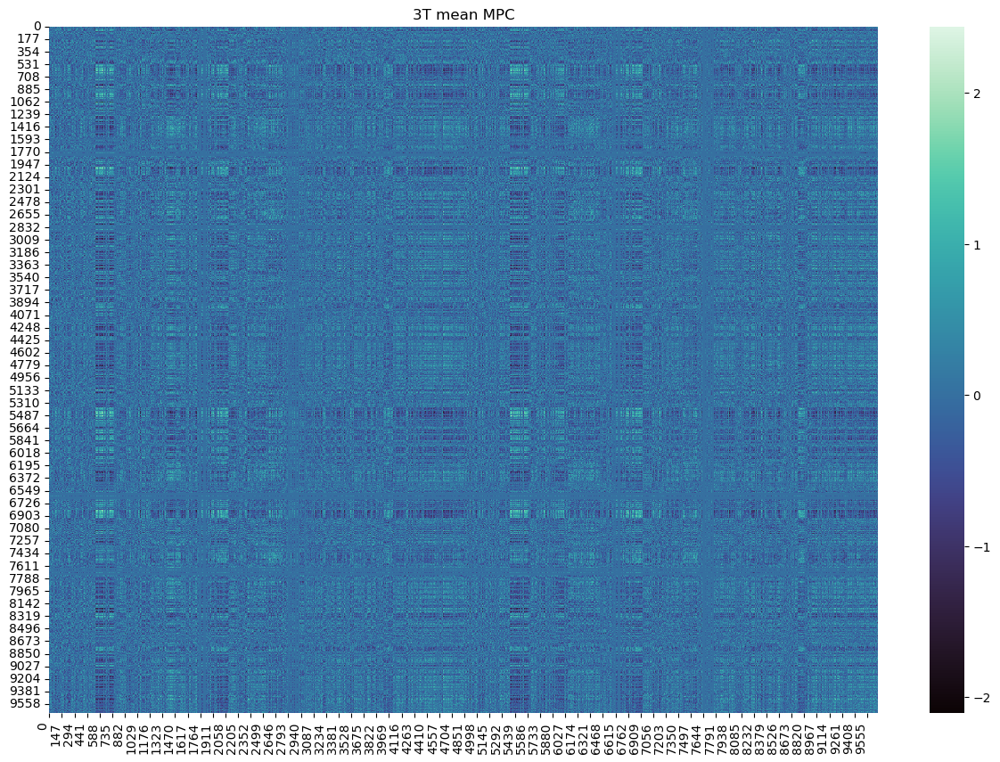

In [207]:
# plot the matrix connectome
plot_connectome(mpc_5k_mean, Title='3T mean MPC', xlab='', ylab='', col='mako', vmin=None, vmax=None,
                   xticklabels='auto', yticklabels='auto',xrot=90, yrot=0)

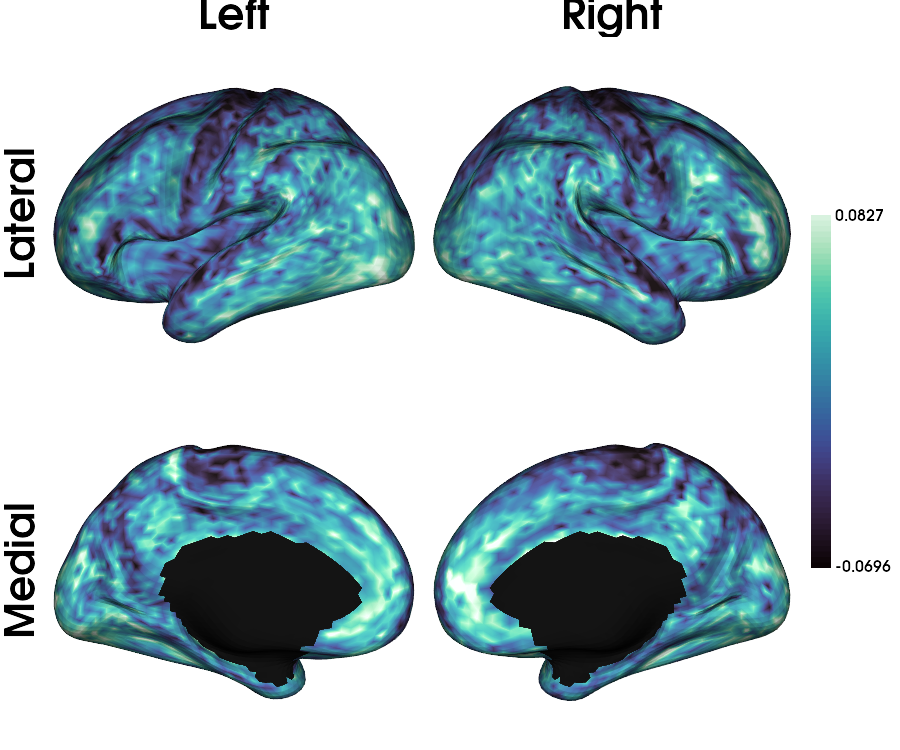

In [208]:
# Calculate the column mean
map_mean=np.mean(mpc_5k_mean, axis=1)

# plot the column mean of the mean connectome surface
crange=(np.quantile(map_mean[mask_surf], 0.01), np.quantile(map_mean[mask_surf], 0.99))
map_mean[mask_surf == False] = np.nan

plot_hemispheres(inf_lh, inf_rh, array_name=map_mean, cmap='mako', nan_color=(0, 0, 0, 1), 
                 transparent_bg=True, zoom=1.3, size=(900, 750), embed_nb=True, color_bar='right', 
                 layout_style='grid', color_range=crange,
                 label_text={'left': ['Lateral', 'Medial'], 'top': ['Left', 'Right']}, screenshot=False)

# 7T Functional Connectome

In [209]:
# List the files
fc_file = []
for path in dirs_pni:
    fc_file.extend(glob.glob(f'{path}/func/desc-me_task-rest_bold/surf/*_surf-fsLR-5k_desc-FC.shape.gii'))
N = len(fc_file)
print(f"Numer of FC: {N}") 

# Loads all the MPC fsLR-5k matrices
fc_5k=np.empty([N5k, N5k, len(fc_file)], dtype=float)
for i, f in enumerate(fc_file):
    fc_5k[:,:,i] = load_fc(f)

# Calculate the mean connectome
fc_5k_mean = np.mean(fc_5k, axis=2)

fc_file

Numer of FC: 18


/host/yeatman/local_raid/temporaryLocalProcessing/ipykernel_37091/3092911582.py:34: RuntimeWarning: divide by zero encountered in arctanh
  FCz = np.arctanh(FC)


['BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC018/ses-03/func/desc-me_task-rest_bold/surf/sub-PNC018_ses-03_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC018/ses-01/func/desc-me_task-rest_bold/surf/sub-PNC018_ses-01_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC018/ses-02/func/desc-me_task-rest_bold/surf/sub-PNC018_ses-02_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC018/ses-04/func/desc-me_task-rest_bold/surf/sub-PNC018_ses-04_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC019/ses-03/func/desc-me_task-rest_bold/surf/sub-PNC019_ses-03_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC019/ses-01/func/desc-me_task-rest_bold/surf/sub-PNC019_ses-01_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_PNI/derivatives/micapipe_v0.2.0/sub-PNC019/ses-02/func/desc-me_task-rest_bold/surf/sub-PNC019_ses-02_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_PNI/de

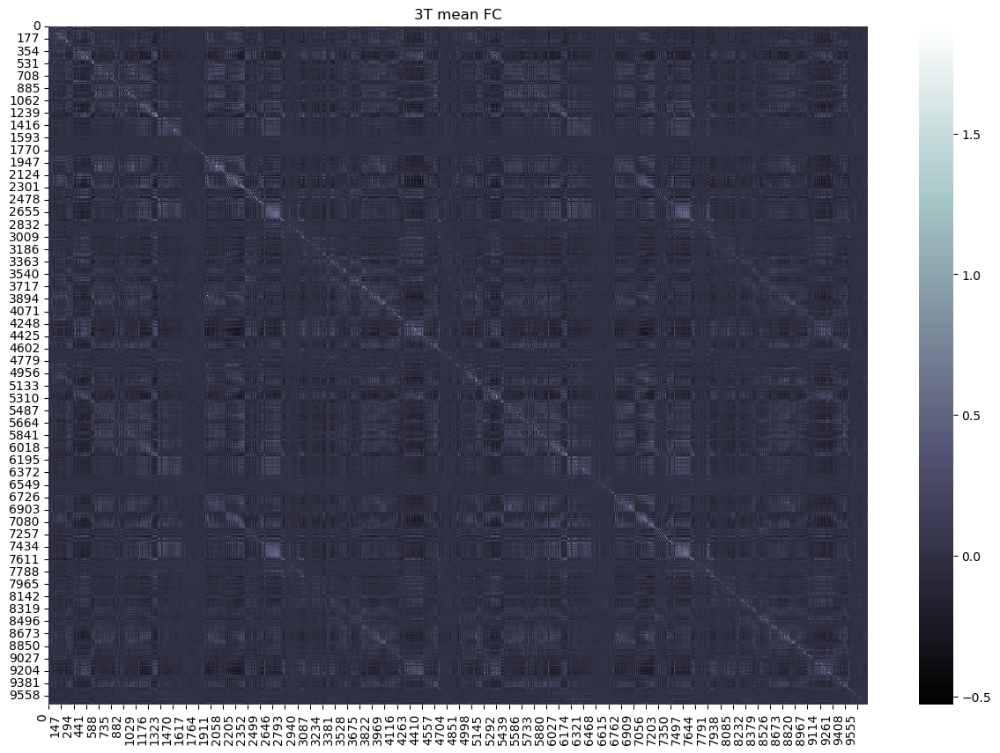

In [210]:
# plot the matrix connectome
plot_connectome(fc_5k_mean, Title='3T mean FC', xlab='', ylab='', col='bone', vmin=None, vmax=None,
                   xticklabels='auto', yticklabels='auto',xrot=90, yrot=0)

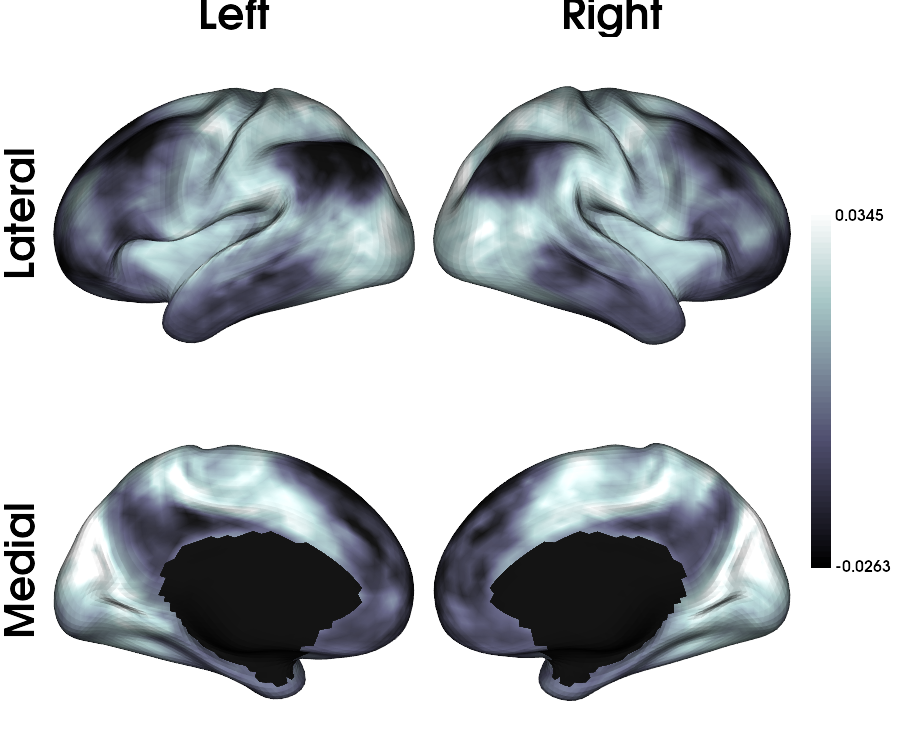

In [211]:
# Calculate the column mean
map_mean=np.mean(fc_5k_mean, axis=1)

# plot the column mean of the mean connectome surface
crange=(np.quantile(map_mean[mask_surf], 0.01), np.quantile(map_mean[mask_surf], 0.99))
map_mean[mask_surf == False] = np.nan

plot_hemispheres(inf_lh, inf_rh, array_name=map_mean, cmap='bone', nan_color=(0, 0, 0, 1), 
                 transparent_bg=True, zoom=1.3, size=(900, 750), embed_nb=True, color_bar='right', 
                 layout_style='grid', color_range=crange,
                 label_text={'left': ['Lateral', 'Medial'], 'top': ['Left', 'Right']}, screenshot=False)

# 3T Functional Connectome

In [212]:
# List the files
fc_file = []
for path in dirs_mic:
    fc_file.extend(glob.glob(f'{path}/func/desc-se_task-rest_acq-AP_bold/surf/*_surf-fsLR-5k_desc-FC.shape.gii'))
N = len(fc_file)
print(f"Numer of FC: {N}") 

# Loads all the MPC fsLR-5k matrices
fc_5k=np.empty([N5k, N5k, len(fc_file)], dtype=float)
for i, f in enumerate(fc_file):
    fc_5k[:,:,i] = load_fc(f)

# Calculate the mean connectome
fc_5k_mean = np.mean(fc_5k, axis=2)

fc_file

Numer of FC: 8


/host/yeatman/local_raid/temporaryLocalProcessing/ipykernel_37091/3092911582.py:34: RuntimeWarning: divide by zero encountered in arctanh
  FCz = np.arctanh(FC)


['BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC076/ses-01/func/desc-se_task-rest_acq-AP_bold/surf/sub-HC076_ses-01_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC076/ses-02/func/desc-se_task-rest_acq-AP_bold/surf/sub-HC076_ses-02_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC062/ses-03/func/desc-se_task-rest_acq-AP_bold/surf/sub-HC062_ses-03_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC083/ses-01/func/desc-se_task-rest_acq-AP_bold/surf/sub-HC083_ses-01_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC081/ses-01/func/desc-se_task-rest_acq-AP_bold/surf/sub-HC081_ses-01_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC081/ses-02/func/desc-se_task-rest_acq-AP_bold/surf/sub-HC081_ses-02_surf-fsLR-5k_desc-FC.shape.gii',
 'BIDS_MICs/derivatives/micapipe_v0.2.0/sub-HC082/ses-01/func/desc-se_task-rest_acq-AP_bold/surf/sub-HC082_ses-01_surf

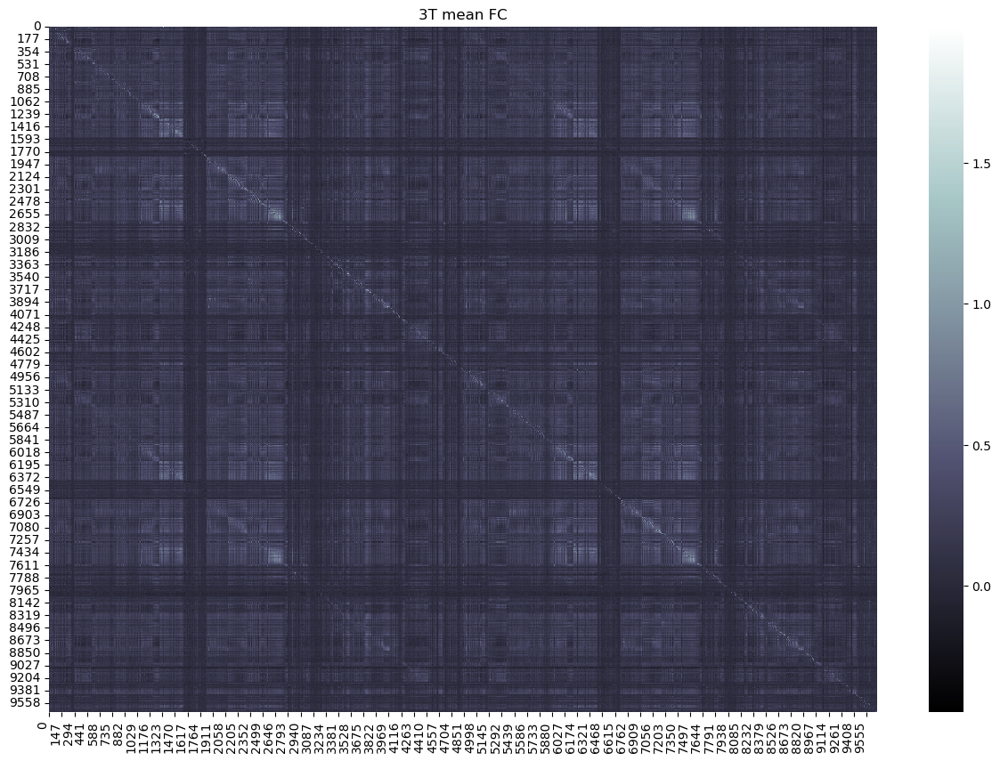

In [213]:
# plot the matrix connectome
plot_connectome(fc_5k_mean, Title='3T mean FC', xlab='', ylab='', col='bone', vmin=None, vmax=None,
                   xticklabels='auto', yticklabels='auto',xrot=90, yrot=0)

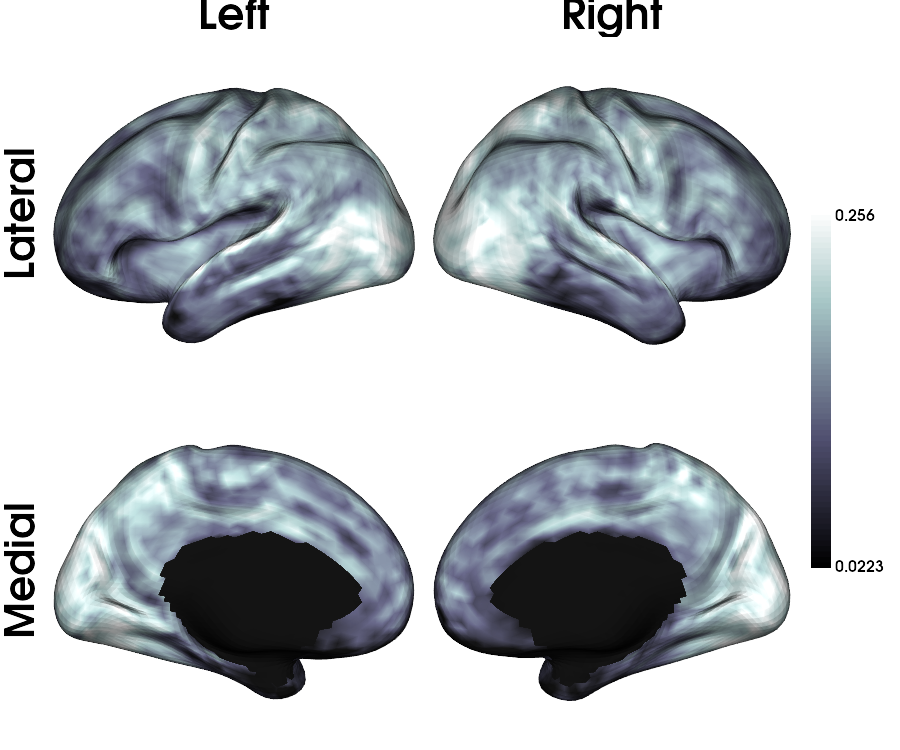

In [214]:
# Calculate the column mean
map_mean=np.mean(fc_5k_mean, axis=1)

# plot the column mean of the mean connectome surface
crange=(np.quantile(map_mean[mask_surf], 0.01), np.quantile(map_mean[mask_surf], 0.99))
map_mean[mask_surf == False] = np.nan

plot_hemispheres(inf_lh, inf_rh, array_name=map_mean, cmap='bone', nan_color=(0, 0, 0, 1), 
                 transparent_bg=True, zoom=1.3, size=(900, 750), embed_nb=True, color_bar='right', 
                 layout_style='grid', color_range=crange,
                 label_text={'left': ['Lateral', 'Medial'], 'top': ['Left', 'Right']}, screenshot=False)